<h1 align="center">Final Capstone Project</h1> 
<h2 align="center">A Data-Driven Guide to Berlin's Neighborhoods for University Students</h2> 
<h2 align="center"><em>by Thithat (Theo) Promlikitchai</em></h2> 

##  1. Introduction

Berlin is one of the most populous cities in the European Union with an estimated population of 3.6 million in 2021. The city's rich history of immigrants and its inclusive attitude towards diverse identities have made the city an international destination for highly skilled, young talents. Besides its cultural assets and lively social scenes, Berlin also boasts a number of world-renowned universities and research institutions recognized by the Times Higher Education such as the Free University of Berlin and the Humboldt University of Berlin. Furthermore, Berlin offers a great selection of post-graduation opportunities in its start-up world or in one of its fast-growing service, creative, and high-tech industries.

This project aims to respond to Berlin's ability to attract both domestic and international students by tackling one of the biggest concerns facing this demographic: relocating to and settling in a new city. Thus, the problem statement can be phrased as the following questions:

> Which neighborhoods in Berlin are most appealing to university students? How can we characterize the experiences of living in one of these neighborhoods?

Although several subjective factors will contribute to such a decision, this project will examine quantifiable factors such as average rent prices, demography, and average commute distances to surrounding universities. In addition, venues surrounding public transport stations will be used to create different clusters. These clusters will help describe the amenities available in each neighborhood and further tailor the project's recommendations to the unique needs of each student. 


###  1.1 Business Case

This project will benefit stakeholders including but not limited to:

1. **Prospective University Students:** Students will be able to narrow down their apartment search to areas that best suit their lifestyle choices and other specifications, making the process of resettling more convenient.
2. **The City of Berlin:** The municipal government can use data science to help brand Berlin as a student city and promote specific neighborhoods, bringing in additional revenue and an educated workforce. 
3. **Real Estate Companies:** Commercial and residential real estate companies that target university students and young adults can leverage such findings to support their investment decisions and marketing strategy.

## 2. Data 

Below is a list of the data sources used in this project and their description:

* **[Berlin's localities](https://daten.odis-berlin.de/de/dataset/ortsteile/) GeoJSON file for choropleth mapping and CSV file with names, the boroughs they belong to, and respective land area.** Berlin is divided into 12 boroughs (Bezirke), which are then subdivided into a total of 96 localities (Ortsteile). Additional information can be webscraped from [Wikipedia](https://en.m.wikipedia.org/wiki/Boroughs_and_neighborhoods_of_Berlin)
* **A CSV file with a list of universities (Hochschulen and Universitäten) in Berlin obtained from [HochschulKompass](https://www.hochschulkompass.de/hochschulen/hochschulsuche.html?tx_szhrksearch_pi1%5Bsearch%5D=1&tx_szhrksearch_pi1%5BQUICK%5D=1&tx_szhrksearch_pi1%5Bname%5D=&tx_szhrksearch_pi1%5Bbundesland%5D%5B%5D=3&tx_szhrksearch_pi1%5Btraegerschaft%5D=) and [Wikipedia](https://en.wikipedia.org/wiki/Universities_and_research_institutions_in_Berlin).** Coordinates were manually coded using Google Maps.
* **[Public transport stations](https://github.com/okfde/berlin.appsandthecity/tree/gh-pages/downloads) used for clustering**. The raw Excel file was cleaned by referencing Wikipedia to include only [U-Bahn](https://en.wikipedia.org/wiki/List_of_Berlin_U-Bahn_stations) (metro) and [S-Bahn](https://en.wikipedia.org/wiki/List_of_Berlin_S-Bahn_stations) (light rail) stations. Stations beyond the boundaries of Berlin and duplicated stations were dropped, as well as bus & tram stations since the data for these two categories were incomplete. Coordinates were then converted from Gauß-Krüger Zone 4 to WGS84 Decimal Degrees. Rather than using localities, clustering these stations will provide more variation in the results. Furthermore, students who relocated to an urban area are unlikely to own a car, making access to public transportation essential.
* **A [CSV file](https://daten.berlin.de/datensaetze/einwohnerinnen-und-einwohner-den-ortsteilen-berlins-am-31122019) containing demographics by localities.** Data as of December 31st, 2019. The raw CSV file was cleaned by referencing the accompanying metadata.
* **Rent prices by localities webscraped from [HomeDay](https://www.homeday.de/de/blog/mietpreise-berlin-2019/).** Data as of 2019. Unit is in euros per meters squared.
* **Foursquare Venue Data obtained using its API.** In order to segment the public transport stations into clusters, venues within a 700 meters search radius of each station were collected. For this project, neighborhoods are not defined by the localities but rather by the walking catchment around these stations. 700 meters was selected based on the [average walking distance of Berliners](https://moovitapp.com/insights/en/Moovit_Insights_Public_Transit_Index-countries), and this distance is unlikely to result in signficiant overlapping judging from the [average walking distance between stations](https://medium.com/@kristin_baumann/walking-the-berlin-s-u-bahn-network-ec2c0b2642fd). Foursquare [metadata](https://developer.foursquare.com/docs/build-with-foursquare/categories/) was also downloaded to group venue subcategories during data processing.



## 3. Methodology

The steps below provide a general overview of the project's workflow. Each step is hyperlinked to its relevant section of the notebook.

[1. Obtain and clean Berlin's localities into a dataframe. Retrieve the coordinates of each locality using the geocoder.](#3-1)
<hr style="border:1px solid gray"> </hr>

[2. Create a CSV file with the name of Berlin universities and their coordinates using Excel and pandas.](#3-2)
<hr style="border:1px solid gray"> </hr>

[3. Obtain and clean the public transport stations dataset using pandas. Convert the coordinates from GK4 to WGS84.](#3-3)
<hr style="border:1px solid gray"> </hr>

[4. Obtain and clean demographics by localities into a dataframe. Subset localities with the highest population of young adults.](#3-4)
<hr style="border:1px solid gray"> </hr>

[5. Webscrape and clean rent prices by localities into a dataframe. Remove localities with extremely high rent prices.](#3-5)
<hr style="border:1px solid gray"> </hr>

[6. Calculate distances from universities to each locality. Subset localities that are able to reach the highest number of universities within a reasonable commute time.](#3-6)
<hr style="border:1px solid gray"> </hr>

[7. Based on Steps 4, 5, and 6, create a list of final localities that meet the critieria. Subset the public transport stations that will be used for clustering.](#3-7)
<hr style="border:1px solid gray"> </hr>

[8. Obtain and clean venue data using the Foursquare API and public transport stations as the origin points. Use the metadata to organize venue categories into larger groups.](#3-8)
<hr style="border:1px solid gray"> </hr>

[9. Prepare the venue data for clustering using one-hot encoding. Fit the model with K-Means clustering.](#3-9)
<hr style="border:1px solid gray"> </hr>

[10. Visualize final clusters on a map and summarize the characteristics of each cluster using the venue data.](#3-10)
<hr style="border:1px solid gray"> </hr>

### Installing and Importing Packages:

In [1]:
## Webscraping:
from bs4 import BeautifulSoup
import requests
import json
from pandas.io.json import json_normalize
import os

## Data Processing:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None, 'display.max_rows', None, 'max_colwidth', None)
!pip install geopandas
import geopandas as gpd

## Data Viz:
import matplotlib.pyplot as plt
!pip install folium
import folium
import seaborn as sns

## Spatial Data:
!pip install geopy
from geopy.geocoders import Nominatim
!pip install pyproj
import pyproj
!pip install haversine
import haversine as hs

## Machine Learning:
from sklearn.cluster import KMeans

## Misc:
import warnings
warnings.filterwarnings("ignore")
from IPython.display import clear_output
from tqdm import tqdm_notebook as tqdm
!pip install dataframe_image
import dataframe_image as dfi

clear_output()
print('Done!')

Done!


<a id="3-1"></a>
### 3.1 Creating the Berlin Localities dataframe

In [2]:
ortsteile = pd.read_csv('https://tsb-opendata.s3.eu-central-1.amazonaws.com/ortsteile/lor_ortsteile.csv')
ortsteile.drop(['gml_id','spatial_name','spatial_alias','spatial_type'], axis = 1, inplace = True) # Keeping only columns that are needed
ortsteile.columns = ['Locality','Borough','Area (ha)'] # Renaming columns
ortsteile = ortsteile[['Borough','Locality','Area (ha)']] # Reordering dataframe 
ortsteile.head()

,Borough,Locality,Area (ha)
0,Mitte,Mitte,1063.8748
1,Mitte,Moabit,768.7909
2,Mitte,Hansaviertel,52.5337
3,Mitte,Tiergarten,516.0672
4,Mitte,Wedding,919.9112


The dataframe contains information for all 12 boroughs and 96 localities in Berlin.

In [3]:
print('Number of Localities:', ortsteile.shape[0])
print('Number of Boroughs:', ortsteile['Borough'].nunique())

Number of Localities: 96
Number of Boroughs: 12


While the GeoJSON file contains coordinates outlining the polygon edges for each locality, it is difficult to extract these coordinates into a dataframe. To add geographical coordinates to the <code>ortsteile</code> dataframe, a geocoder is used instead.

In [4]:
def getcoordinates(locality): # Creating a function that geocodes each address
    geolocator = Nominatim(user_agent="Berlin_OTEIL")
    location = geolocator.geocode('{}, Berlin, Germany'.format(locality))
    if location == None:
        pass
    else:
        latitude = location.latitude
        longitude = location.longitude
        return latitude,longitude

locality_list = list(ortsteile['Locality'])
## Creating empty lists to hold the results
lat = []
long = []

for l in tqdm(locality_list): # Looping through the locality list
    result = getcoordinates(l)
    lat.append(result[0])
    long.append(result[1])

  0%|          | 0/96 [00:00<?, ?it/s]

In [5]:
## Attaching the two lists to the dataframe
ortsteile['Latitude'] = lat
ortsteile['Longitude'] = long

print(ortsteile['Latitude'].isnull().sum(), 'null latitude values')
print(ortsteile['Longitude'].isnull().sum(), 'null longitude values')
ortsteile.head(10)

0 null latitude values
0 null longitude values


,Borough,Locality,Area (ha),Latitude,Longitude
0,Mitte,Mitte,1063.8748,52.517885,13.404060
1,Mitte,Moabit,768.7909,52.530102,13.342542
2,Mitte,Hansaviertel,52.5337,52.519123,13.341872
3,Mitte,Tiergarten,516.0672,52.509778,13.357260
4,Mitte,Wedding,919.9112,52.550123,13.341970
5,Mitte,Gesundbrunnen,610.8368,52.550920,13.384846
6,Friedrichshain-Kreuzberg,Friedrichshain,991.2352,52.512215,13.450290
7,Friedrichshain-Kreuzberg,Kreuzberg,1033.9178,52.497644,13.411914
8,Pankow,Prenzlauer Berg,1096.9869,52.539847,13.428565
9,Pankow,Weißensee,790.4559,52.554619,13.463002


After comparing the coordinates in the above dataframe with the geojson file, two localities were incorrectly coded. <code>Reinickendorf</code> and <code>Pankow</code> were given coordinates of their boroughs, which happen to have the same name. Let's manually recode them.

In [6]:
## Reinickendorf
ortsteile.at[85,'Latitude'] = 52.566667
ortsteile.at[85,'Longitude'] = 13.333333
## Pankow
ortsteile.at[14,'Latitude'] = 52.569167
ortsteile.at[14,'Longitude'] = 13.403333

<a id="3-2"></a>
### 3.2 Creating the Berlin Universities dataframe

After obtaining the names of 39 universities from HochschulKompass and Wikipedia, their coordinates were manually coded using Google Maps, and the resulting CSV file was compiled through Excel. Using geopy's geocoder as above returned several <code>None</code>values, possibly because some university names contain special characters that may not have been translated correctly by the API. 

In [7]:
uni = pd.read_csv('Berlin_Unis.csv', encoding='utf-8')
uni.columns = ['Uni Name','Coordinates']

## Splitting the geographical coordinates into two columns
uni['Latitude'] = uni['Coordinates'].apply(lambda x: float(x.split(',')[0]))
uni['Longitude'] = uni['Coordinates'].apply(lambda x: float(x.split(',')[1]))
uni.drop('Coordinates', axis = 1, inplace = True)
uni.head(10)

,Uni Name,Latitude,Longitude
0,Akkon Hochschule,52.455717,13.394513
1,Alice Salomon Hochschule Berlin,52.537730,13.605772
2,Bard College Berlin,52.584904,13.393675
3,Barenboim-Said Akademie,52.515498,13.396117
4,bbw Hochschule Berlin,52.511779,13.315078
5,Berlin International University of Applied Sciences,52.515984,13.328148
6,Beuth Hochschule für Technik Berlin,52.545051,13.351918
7,BSP Business School Berlin,52.438900,13.328727
8,Charité – Universitätsmedizin Berlin,52.441051,13.321002
9,CODE University of Applied Sciences,52.493654,13.446913


Let's visualize the distribution of universities in Berlin using Folium

In [8]:
gdf_oteil = gpd.read_file('lor_ortsteile.geojson') # Reading geojson file into a geodataframe

berlin_unis = folium.Map(location=[52.520008, 13.404954], tiles="cartodbpositron", zoom_start=10) # Creating basemap using coordinates for Berlin

## Adding locality polygons with tooltips
folium.features.GeoJson(data = gdf_oteil,name='Labels',style_function=lambda x: {'color':'black','fillColor':'black','weight':1,'opacity':0.4},
                        tooltip=folium.features.GeoJsonTooltip(fields=['OTEIL'], aliases = ['Locality'],labels=True, sticky=True)).add_to(berlin_unis)

universities = folium.map.FeatureGroup() # Initiating a new feature group
for lat, long, label in zip(uni['Latitude'], uni['Longitude'],uni['Uni Name']): # Looping through uni dataframe and adding a marker to the feature group
    universities.add_child(folium.features.CircleMarker([lat, long],radius=3, color='green', fill=True,fill_color='green',fill_opacity=0.8,popup=label))
berlin_unis.add_child(universities)

berlin_unis

As expected, universities in Berlin tend to be concentrated in the city center, while a few outliers are located in the outer localities.

<a id="3-3"></a>
### 3.3 Creating the Train Stations Dataframe

The raw Excel file <code>Bahnhöfe_mit_Zugangskoordinaten_BERLIN</code> contains not only the location of train station but also data points for entrances, transfer points, platforms at each station. Let's only subset rows that correspond to a structure (<code>Typ = Bauwerk</code>) for processing.

In [9]:
rawdf = pd.read_csv('Bahnhöfe_BERLIN.csv',encoding = 'utf-8', header = 2)
stations = rawdf[rawdf['Typ'] == 'Bauwerk'] # Subsetting only structural types
stations = stations[['Name','X','Y']] # Keeping only columns that are needed
stations.reset_index(drop = True, inplace = True) 
stations.columns = ['Station Name','GK_X','GK_Y'] # Renaming columns


print('Total number of data points:',stations.shape[0])
stations.head(10)

Total number of data points: 351


,Station Name,GK_X,GK_Y
0,U Nollendorfplatz,4592040.0,5819360.0
1,S+U Alexanderplatz Bhf,4596000.0,5821830.0
2,S+U Friedrichstraße Bhf.,4594350.0,5821680.0
3,U Mehringdamm,4594353.0,5818672.0
4,S+U Wuhletal,4607060.0,5821100.0
5,U Berliner Straße,4590540.0,5817930.0
6,U Kurfürstendamm,4590510.0,5819790.0
7,U Spichernstraße,4590470.0,5818990.0
8,U Fehrbelliner Platz,4589390.0,5818260.0
9,S+U Bundesplatz,4590410.0,5816850.0


Let's create a function to join the Gauß-Krüger coordinates into one column to faciliate converting them from GK Zone 4 to WGS84 DD using pyproj.

In [10]:
def joinGKcoor(df): # Function that joins GK X and Y
    return (df['GK_X'],df['GK_Y'])
stations['GK_Coordinates']=stations.apply(joinGKcoor,axis = 1)
proj_wgs84 = pyproj.Proj(init="epsg:4326") # Initializing the wgs84 projection
proj_gk4 = pyproj.Proj(init="epsg:31468") # Initializing the gk4 projection

GK_coors = list(stations['GK_Coordinates'])

## Creating empty lists as placeholders
lat = []
long = []

for coor in tqdm(GK_coors): # Looping through the GK coordinates to transform them to WGS84 DD
    result = pyproj.transform(proj_gk4, proj_wgs84, coor[0], coor[1])
    lat.append(result[1]) # GK_Y is the latitude
    long.append(result[0]) # GK_X is the longitude

## Adding them to the stations dataframe
stations['Latitude'] = lat
stations['Longitude'] = long

  0%|          | 0/351 [00:00<?, ?it/s]

Let's remove stations that are beyond the boundaries of Berlin and duplicated stations (i.e. an S- or U-Bahn station that is also coded as S+U). Let's also drop bus and tram stops since the data for these two categories are incomplete. Their <code>Station Name</code> typically contain the name of another S- or U-Bahn station plus the Straße (road) they are situated on.

In [11]:
## Keeping dropped stations just in case
droppedstations = stations.loc[[275,348,277,177,278,349,268,61,336,321,317,300,282,340,284,334,288,298,297,294,285,324,307,344,308,343,
                                    342,316,287,318,315,346,305,304,306,302,350,296,295,168,310,326,327,328,329,319,320,345,337,290,313,312,330,
                                    331,332,339,292,335,322,323,333,309,325,289,347,281,301,341,303,293,283,314,286,338]]

## Creating the final station dataframe
stationsfinal = stations.drop([275,348,277,177,278,349,268,61,336,321,317,300,282,340,284,334,288,298,297,294,285,324,307,344,308,343,
                                    342,316,287,318,315,346,305,304,306,302,350,296,295,168,310,326,327,328,329,319,320,345,337,290,313,312,330,
                                    331,332,339,292,335,322,323,333,309,325,289,347,281,301,341,303,293,283,314,286,338],axis = 0)
stationsfinal.reset_index(drop = True, inplace = True)
stationsfinal.drop(['GK_X','GK_Y','GK_Coordinates'],axis = 1, inplace = True)

print('Total number of data points:',stationsfinal.shape[0])
stationsfinal.head(10)

Total number of data points: 277


,Station Name,Latitude,Longitude
0,U Nollendorfplatz,52.499632,13.353806
1,S+U Alexanderplatz Bhf,52.521140,13.412813
2,S+U Friedrichstraße Bhf.,52.520081,13.388469
3,U Mehringdamm,52.493057,13.387661
4,S+U Wuhletal,52.512525,13.575458
5,U Berliner Straße,52.487036,13.331336
6,U Kurfürstendamm,52.503751,13.331400
7,U Spichernstraße,52.496570,13.330594
8,U Fehrbelliner Platz,52.490190,13.314500
9,S+U Bundesplatz,52.477354,13.329131


Let's reverse code these coordinates using a geocoder to add the locality and borough that each station belongs to.

In [12]:
def joincoor(df): # Function that joins latitude and longitude 
    return (df['Latitude'],df['Longitude'])
stationsfinal['Coordinates'] = stationsfinal.apply(joincoor,axis = 1) # Joining latitudes and longitudes

def getlocality(coordinate): # Creating a function that reverses each coordinate
    geolocator = Nominatim(user_agent="Berlin_OTEIL")
    location = geolocator.reverse("{},{}".format(coordinate[0],coordinate[1]))
    if location == None:
        pass
    else:
        borough = location.raw['address']['borough']
        try:
            locality = location.raw['address']['suburb']
        except:
            locality = location.raw['address']['neighbourhood']
        return borough,locality
    
coor_list = list(stationsfinal['Coordinates'])

## Creating empty lists as placeholders
bor_list = []
loc_list = []

for c in tqdm(coor_list): # Looping through the coordinates list
    result = getlocality(c)
    bor_list.append(result[0])
    loc_list.append(result[1])

## Adding them to the final stations dataframe 
stationsfinal['Locality'] = loc_list
stationsfinal['Borough'] = bor_list

## Recoding the Schlachtensee locality as Zehlendorf. Schlachtensee was designated as a locality in December 2020, so most datasets have not reflected this change.
stationsfinal['Locality'].replace('Schlachtensee','Zehlendorf', inplace = True)

stationsfinal.head(10)

  0%|          | 0/277 [00:00<?, ?it/s]

,Station Name,Latitude,Longitude,Coordinates,Locality,Borough
0,U Nollendorfplatz,52.499632,13.353806,"(52.49963227056085, 13.353806488998885)",Schöneberg,Tempelhof-Schöneberg
1,S+U Alexanderplatz Bhf,52.521140,13.412813,"(52.52114049134575, 13.412812508479956)",Mitte,Mitte
2,S+U Friedrichstraße Bhf.,52.520081,13.388469,"(52.52008070513163, 13.388468844400736)",Mitte,Mitte
3,U Mehringdamm,52.493057,13.387661,"(52.49305659167182, 13.387661073581715)",Kreuzberg,Friedrichshain-Kreuzberg
4,S+U Wuhletal,52.512525,13.575458,"(52.51252492621626, 13.575458026701142)",Hellersdorf,Marzahn-Hellersdorf
5,U Berliner Straße,52.487036,13.331336,"(52.48703570761596, 13.331336450732577)",Wilmersdorf,Charlottenburg-Wilmersdorf
6,U Kurfürstendamm,52.503751,13.331400,"(52.503751173372585, 13.331399951513173)",Charlottenburg,Charlottenburg-Wilmersdorf
7,U Spichernstraße,52.496570,13.330594,"(52.49657049735864, 13.330593877009683)",Wilmersdorf,Charlottenburg-Wilmersdorf
8,U Fehrbelliner Platz,52.490190,13.314500,"(52.4901898645656, 13.314500318138746)",Wilmersdorf,Charlottenburg-Wilmersdorf
9,S+U Bundesplatz,52.477354,13.329131,"(52.47735433870235, 13.329130565814053)",Friedenau,Tempelhof-Schöneberg


Finally, let's visualize the distribution of S- and U-Bahn stations in Berlin using Folium.

In [13]:
stationsfinal = stationsfinal[['Station Name','Locality','Borough','Latitude','Longitude','Coordinates']]

berlin_stations = folium.Map(location=[52.520008, 13.404954], tiles="cartodbpositron", zoom_start=10) # Creating basemap using coordinates for Berlin

folium.features.GeoJson(data = gdf_oteil,name='Labels',style_function=lambda x: {'color':'black','fillColor':'black','weight':1,'opacity':0.3},
                        tooltip=folium.features.GeoJsonTooltip(fields=['OTEIL'], aliases = ['Locality'],labels=True, sticky=True)).add_to(berlin_stations)

stops = folium.map.FeatureGroup() # Initiating a new feature group
## Looping through stationsfinal dataframe and adding a marker to the feature group
for lat, long, label,index in zip(stationsfinal['Latitude'],stationsfinal['Longitude'],stationsfinal['Station Name'],stationsfinal.index): 
    stops.add_child(folium.features.CircleMarker([lat, long],radius=2, color='teal', fill=True,fill_color='teal',fill_opacity=0.8,popup=(index,label)))

berlin_stations.add_child(stops)

berlin_stations

Based on the map above, not every locality in Berlin contains an S- or U-Bahn station. As expected, these stations tend to be more concentrated near the city center. It is also important to note that the outer localities are more likely to be serviced by bus or tram lines, which were excluded from this analysis.

<a id="3-4"></a>
### 3.4 Creating the Demographics Dataframe

In [14]:
url = 'https://download.statistik-berlin-brandenburg.de/9d95cda1ebed6261/f46cf90493b9/EWR_Ortsteile_2019-12-31.csv'
demographics = pd.read_csv(url, sep = ';', header = 0, encoding= 'iso-8859-1')

demographics.columns = ['District No.','District Name', 'Locality No.','Locality Name', 'Gender','Citizenship','Age Group','Pop. Count']
demographics.drop(['District No.','Locality No.'], axis = 1, inplace = True)
demographics.head()

,District Name,Locality Name,Gender,Citizenship,Age Group,Pop. Count
0,Mitte,Mitte,1,A,00_05,564
1,Mitte,Mitte,1,A,05_10,435
2,Mitte,Mitte,1,A,10_15,316
3,Mitte,Mitte,1,A,15_20,384
4,Mitte,Mitte,1,A,20_25,1329


According to the metadata, for the <code>Gender</code> column, 1 represents male and 2 represents female, and for the <code>Citizenship</code> column, A represents noncitizens and D represents citizens. Let's recode these values and regroup the Age Group into larger groups.

In [15]:
demographics['Gender'] = demographics['Gender'].apply(lambda x: 'Male' if x == 1 else 'Female') # Recoding Gender
demographics['Citizenship'] = demographics['Citizenship'].apply(lambda x: 'Non-Citizens' if x == 'A' else 'Citizens') # Recoding Citizenship
demographics['Age Group'] = demographics['Age Group'].str.replace('_','-') # Cleaning Age Group

def ageregroup(x): # Regrouping age groups
    if x == '00-05' or  x == '05-10'or x == '10-15':
        return '0-15'
    elif x == '15-20' or x == '20-25' or x == '25-30':
        return '15-30'
    elif x == '30-35' or x == '35-40' or x == '40-45' or x == '45-50':
        return '30-50'
    elif x == '50-55' or x == '55-60' or x == '60-65' or x == '65-70':
        return '50-70'
    else:
        return '70 and older'
demographics['Age Group'] = demographics['Age Group'].apply(ageregroup)

Let's condense the dataframe and calculate the proportion of young adults (15-30 years old) for each locality for choropleth mapping.

In [16]:
groupeddemo = demographics.groupby(['Locality Name','Age Group']).sum() # Grouping by locality name then age group and summing the count
groupeddemo.reset_index(inplace = True)

## Calculating the proportion of young adults out of the total population by locality
proportion_list = []
for name in groupeddemo['Locality Name']:
    subset = groupeddemo[groupeddemo['Locality Name'] == name]
    proportion = round((float((subset[subset['Age Group']  == '15-30']['Pop. Count'].values))/subset['Pop. Count'].sum()) * 100,2)
    proportion_list.append(proportion)
groupeddemo['Young Adult Proportion(%)'] = proportion_list

## Keeping only columns that are needed
youngadults = groupeddemo[groupeddemo['Age Group'] == '15-30'][['Locality Name','Pop. Count','Young Adult Proportion(%)']]
youngadults.reset_index(drop = True, inplace = True)
youngadults.head()

,Locality Name,Pop. Count,Young Adult Proportion(%)
0,Adlershof,3930,19.72
1,Alt-Hohenschönhausen,7219,14.74
2,Alt-Treptow,1920,14.91
3,Altglienicke,4299,14.64
4,Baumschulenweg,2936,15.58


Finally, let's visualize the proportion of young adults by localities using Folium and subset localities with the highest proportion of young adults (top 50%).

In [17]:
with open('lor_ortsteile.geojson') as access_json: # Loading the Berlin ortsteile geoJSON
    berlin_geo = json.load(access_json)
    
## Creating a new geodataframe with both geometries and attribute data for labeling 
gdf_merged = pd.merge(gdf_oteil, youngadults,left_on = 'OTEIL',right_on = 'Locality Name')
gdf_youngadults = gpd.GeoDataFrame(gdf_merged)

youngadults_berlin = folium.Map(location=[52.520008, 13.404954], tiles="cartodbpositron", zoom_start=10) # Creating a basemap of Berlin

## Plotting a choropleth map of young adults
youngadults_berlin.choropleth(geo_data = berlin_geo,data = youngadults,columns =['Locality Name', 'Young Adult Proportion(%)'],
                              key_on ='feature.properties.OTEIL',fill_color = 'YlGnBu',fill_opacity = 0.7,line_opacity = 0.3,
                              legend_name='Young Adult Proportion(%)')

## Adding a transparent geojson layer for labeling
folium.features.GeoJson(data = gdf_youngadults,name='Labels',style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
                        tooltip=folium.features.GeoJsonTooltip(fields=['OTEIL','Young Adult Proportion(%)'], aliases = ['Locality:','Young Adult Proportion in %:'],
                                                               labels=True, sticky=True)).add_to(youngadults_berlin)

youngadults_berlin

Judging from the map above, localities in central Berlin tend to have a higher proportion of young adults compared to localities on the periphery. However, confirming whether a significant spatial autocorrelation exists would have to be done using a geographic information system.

In [18]:
youngadults.sort_values(by = 'Young Adult Proportion(%)', ascending = False, inplace = True)
youngadults_final = youngadults.head(48) # Subsetting the upper half of the young adults dataframe
youngadults_final.reset_index(drop = True, inplace = True)

print('Number of localities:', youngadults_final.shape[0])
youngadults_final.head(10)

Number of localities: 48


,Locality Name,Pop. Count,Young Adult Proportion(%)
0,Hansaviertel,1632,27.54
1,Wedding,21406,24.66
2,Gesundbrunnen,22910,24.07
3,Moabit,19156,23.80
4,Oberschöneweide,5369,22.85
5,Tiergarten,3362,22.59
6,Lichtenberg,8513,20.39
7,Niederschöneweide,2612,20.33
8,Neukölln,33611,20.23
9,Spandau,7936,20.06


<a id="3-5"></a>
### 3.5 Creating the Rent Prices Dataframe

Let's webscrape the Homeday website and prepare the dataframe for choropleth mapping.

In [19]:
## Obtaining the html data and locating the table
url = 'https://www.homeday.de/de/blog/mietpreise-berlin-2019/'
price_data = requests.get(url).text
soup = BeautifulSoup(price_data,"html5lib")
price_table = soup.find('tbody')

## Looping through the row to create a list of dictionaries
price_table_contents = []
for row in price_table.find_all('tr'):
    cell = {}
    cell['Locality Name'] = row.find_all('td')[0].text
    cell['Rent Prices 2016(€)'] = row.find_all('td')[1].text.replace('€','').replace(',','.')
    cell['Rent Prices 2019(€)'] = row.find_all('td')[2].text.replace('€','').replace(',','.')
    cell['Price Change(%)'] = row.find_all('td')[3].text.replace('%','').replace(',','.')
    price_table_contents.append(cell)

## Casting the list into a dataframe and cleaning special characters
rent_prices = pd.DataFrame(price_table_contents)
rent_prices['Rent Prices 2016(€)'] = rent_prices['Rent Prices 2016(€)'].astype(float)
rent_prices['Rent Prices 2019(€)'] = rent_prices['Rent Prices 2019(€)'].astype(float)
rent_prices['Price Change(%)'] = rent_prices['Price Change(%)'].astype(float)

rent_prices.head()

,Locality Name,Rent Prices 2016(€),Rent Prices 2019(€),Price Change(%)
0,Tiergarten,11.8,14.0,15.7
1,Friedrichshain,10.8,13.6,20.6
2,Grunewald,10.8,13.0,16.9
3,Rummelsburg,10.8,13.0,16.9
4,Moabit,9.9,12.6,21.4


In [20]:
## Creating a new geodataframe with both geometries and attribute data for labeling 
gdf_merged_two = pd.merge(gdf_oteil, rent_prices,left_on = 'OTEIL',right_on = 'Locality Name')
gdf_rentprices = gpd.GeoDataFrame(gdf_merged_two)

rentprices_berlin = folium.Map(location=[52.520008, 13.404954], tiles="cartodbpositron", zoom_start=10) # Creating a basemap of Berlin

## Plotting a choropleth map of rent prices
rentprices_berlin.choropleth(geo_data = berlin_geo,data = rent_prices,columns =['Locality Name', 'Rent Prices 2019(€)'],
                              key_on ='feature.properties.OTEIL',fill_color = 'YlOrRd',fill_opacity = 0.7,line_opacity = 0.3,
                              legend_name='Rent Prices 2019(€)')

## Adding a transparent geojson layer for labeling
folium.features.GeoJson(data = gdf_rentprices,name='Labels',style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
                        tooltip=folium.features.GeoJsonTooltip(fields=['OTEIL','Rent Prices 2019(€)'], aliases = ['Locality:','2019 Rent Prices in Euros:'],
                                                               labels=True, sticky=True)).add_to(rentprices_berlin)

rentprices_berlin

Unsurprisingly, the most expensive localities are the most popular places to live in Berlin such as Tiergarten, Friedrichshain, Kreuzberg, and Prenzlauer Berg, while the cheaper localities are located in the outer edges of Berlin, especially the Eastern side. Let's now subset localities by removing those with extremely high rent prices (top 20%).

In [21]:
rent_prices.sort_values(by = 'Rent Prices 2019(€)', ascending = False, inplace = True)
rentprices_final = rent_prices.tail(77) # Subsetting the bottom 80% after sorting values
rentprices_final.reset_index(drop = True, inplace = True)

print('Number of localities:', rentprices_final.shape[0])
rentprices_final.head(10)

Number of localities: 77


,Locality Name,Rent Prices 2016(€),Rent Prices 2019(€),Price Change(%)
0,Charlottenburg,9.0,11.1,18.9
1,Wedding,8.7,11.0,20.9
2,Pankow,9.1,11.0,17.3
3,Westend,9.3,11.0,15.5
4,Wannsee,9.1,10.8,15.7
5,Steglitz,8.7,10.7,18.7
6,Niederschönhausen,8.6,10.5,18.1
7,Lichterfelde,8.6,10.5,18.1
8,Nikolassee,9.2,10.5,12.4
9,Französisch Buchholz,8.6,10.5,18.1


<a id="3-6"></a>
### 3.6 Calculating Distances from Universities to Localities

To determine which localities are most suitable for university students, the final criterion to consider is the commute distance. Let's calculate the haversine distances from each locality to each university and compile the results into a dataframe.

In [22]:
## Creating copies of the locality and university dataframes
ortsteile_C = ortsteile.copy()
uni_C = uni.copy()

## Joining coordinates to facilitate processing
ortsteile_C['Coordinates'] = ortsteile_C.apply(joincoor,axis = 1)
uni_C['Coordinates'] = uni_C.apply(joincoor,axis = 1)

## Creating lists as empty placeholders
distances = []
locality_coordinates = []
uni_coordinates = []

for coor_1 in ortsteile_C['Coordinates']: # Looping through locality coordinates
    loc1_lat = coor_1[0]
    loc1_long = coor_1[1]
    location_1 = loc1_lat,loc1_long
    for coor_2 in uni_C['Coordinates']: # Looping through university coordinates
        loc2_lat = coor_2[0]
        loc2_long = coor_2[1]
        location_2 = loc2_lat,loc2_long
        # Saving locality coordinates to list
        locality_coordinates.append(location_1)
        # Saving university coordinates to list
        uni_coordinates.append(location_2)
        # Calculating distances and appending to list
        distance = hs.haversine(location_1,location_2)
        distances.append(distance)
        
## Initializing a new dataframe
distancetouni = pd.DataFrame()        
distancetouni['Locality Coordinates'] = locality_coordinates
distancetouni['Uni Coordinates'] = uni_coordinates
distancetouni['Distance(km)'] = distances

distancetouni.head()

,Locality Coordinates,Uni Coordinates,Distance(km)
0,"(52.5178855, 13.4040601)","(52.4557165, 13.39451332)",6.943045
1,"(52.5178855, 13.4040601)","(52.53773045939934, 13.6057719570766)",13.822762
2,"(52.5178855, 13.4040601)","(52.58490390160592, 13.393675257102055)",7.485121
3,"(52.5178855, 13.4040601)","(52.515497782096986, 13.39611744101721)",0.599448
4,"(52.5178855, 13.4040601)","(52.51177910809336, 13.315078395716924)",6.059416


Now, let's retrieve the name of each locality and university by matching coordinates to the two original dataframes using merge.

In [23]:
merged1 = distancetouni.merge(uni_C, left_on = 'Uni Coordinates', right_on = 'Coordinates') # Retrieving university names
merged1_cleaned = merged1[['Locality Coordinates','Uni Coordinates','Uni Name','Distance(km)']]
merged2 = merged1_cleaned.merge(ortsteile_C, left_on = 'Locality Coordinates', right_on = 'Coordinates') # Retrieving locality and borough names
distancetouni_cleaned = merged2[['Locality','Borough','Uni Name','Locality Coordinates','Uni Coordinates','Distance(km)']]

print('Number of localities:',distancetouni_cleaned['Locality'].nunique())
print('Number of universities:',distancetouni_cleaned['Uni Name'].nunique())
distancetouni_cleaned.head()

Number of localities: 96
Number of universities: 39


,Locality,Borough,Uni Name,Locality Coordinates,Uni Coordinates,Distance(km)
0,Mitte,Mitte,Akkon Hochschule,"(52.5178855, 13.4040601)","(52.4557165, 13.39451332)",6.943045
1,Mitte,Mitte,Alice Salomon Hochschule Berlin,"(52.5178855, 13.4040601)","(52.53773045939934, 13.6057719570766)",13.822762
2,Mitte,Mitte,Bard College Berlin,"(52.5178855, 13.4040601)","(52.58490390160592, 13.393675257102055)",7.485121
3,Mitte,Mitte,Barenboim-Said Akademie,"(52.5178855, 13.4040601)","(52.515497782096986, 13.39611744101721)",0.599448
4,Mitte,Mitte,bbw Hochschule Berlin,"(52.5178855, 13.4040601)","(52.51177910809336, 13.315078395716924)",6.059416


According to Moovit Insights, the average commute distance for Berliners on a one-way trip is 8.36 km. Using this value as the reasonable commute distance, let's calculate how many universities one would be able to reach from each locality and subset localities with the highest count (top 50%).

In [24]:
reasonable = distancetouni_cleaned[distancetouni_cleaned['Distance(km)'] <= 8.36] # Passing through condition
grouped_reasonable = reasonable.groupby(['Locality']).count()[['Distance(km)']].reset_index() # Grouping by localities
grouped_reasonable = grouped_reasonable.rename(columns = {'Distance(km)':'Count'})

grouped_reasonable.sort_values('Count', ascending = False, inplace = True) # Sorting by the count
grouped_reasonable.reset_index(drop = True, inplace = True)
distancetouni_final = grouped_reasonable.head(48) # Subsetting upper half

print('Number of localities:', distancetouni_final.shape[0])
distancetouni_final.head(10)

Number of localities: 48


,Locality,Count
0,Tiergarten,31
1,Hansaviertel,30
2,Friedenau,29
3,Wilmersdorf,29
4,Schöneberg,29
5,Mitte,28
6,Moabit,28
7,Kreuzberg,27
8,Gesundbrunnen,27
9,Charlottenburg,27


<a id="3-7"></a>
### 3.7 Selecting Localities for Cluster Analysis

Let's create the final list of localities that pass all three critieria: proportion of young adults, rent prices, and commute distance to universities.

In [25]:
rentxyoung = rentprices_final[rentprices_final['Locality Name'].isin(youngadults_final['Locality Name'])][['Locality Name']]
rentxyoungxdist = rentxyoung[rentxyoung['Locality Name'].isin(distancetouni_final['Locality'])]

print('Final number of localities:', rentxyoungxdist.shape[0])
rentxyoungxdist.reset_index(drop = True, inplace = True)
rentxyoungxdist

Final number of localities: 20


,Locality Name
0,Charlottenburg
1,Wedding
2,Westend
3,Steglitz
4,Tempelhof
5,Gesundbrunnen
6,Lichtenberg
7,Siemensstadt
8,Baumschulenweg
9,Fennpfuhl


Finally, let's select only S- and U-Bahn stations that are located in these localities. These train stations will serve as origin points when obtaining venue data for clustering.

In [26]:
stations_clust = stationsfinal[stationsfinal['Locality'].isin(rentxyoungxdist['Locality Name'])]

print('Final number of stations:', stations_clust.shape[0])
stations_clust.reset_index(drop = True, inplace = True)
stations_clust.head(10)

Final number of stations: 97


,Station Name,Locality,Borough,Latitude,Longitude,Coordinates
0,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,52.503751,13.331400,"(52.503751173372585, 13.331399951513173)"
1,U Hermannplatz,Neukölln,Neukölln,52.486662,13.425104,"(52.48666164269676, 13.425103692805594)"
2,S+U Neukölln,Neukölln,Neukölln,52.469287,13.442349,"(52.46928672732828, 13.442348610493264)"
3,U Leopoldplatz,Wedding,Mitte,52.546481,13.359376,"(52.54648145309053, 13.359376358782079)"
4,U Osloer Straße,Gesundbrunnen,Mitte,52.556926,13.373265,"(52.55692588034981, 13.373265162826831)"
5,U Nauener Platz,Wedding,Mitte,52.551512,13.367346,"(52.55151228022182, 13.367346030253538)"
6,U Amrumer Straße,Wedding,Mitte,52.542191,13.349515,"(52.54219066135152, 13.349515014048293)"
7,U Schloßstraße,Steglitz,Steglitz-Zehlendorf,52.461172,13.324817,"(52.46117182391675, 13.32481734244788)"
8,U Walther-Schreiber-Platz,Steglitz,Tempelhof-Schöneberg,52.464866,13.328754,"(52.46486632555787, 13.32875412101683)"
9,U Britz-Süd,Britz,Neukölln,52.436904,13.448290,"(52.436904492166335, 13.44829003878045)"


<a id="3-8"></a>
### 3.8 Obtaining and Cleaning Venue Data using the Foursquare API

Let's first retrieve all the venues within a 700 meters radius of each S- and U-Bahn station in the <code>stations_clust</code> dataframe. This walking catchment is the project's operational definition of a neighborhood. It is important to note that Foursquare query results will vary depending on the time of the query, which may affect the project's findings. Any results and discussion mentioned below are true at the time of the query.

In [27]:
## Inputting Foursquare credentials
CLIENT_ID = input('Client ID:')
CLIENT_SECRET = input('Client Secret:')
ACCESS_TOKEN = input('Access Token:')
VERSION = '20180605'
LIMIT = 100

clear_output()

In [28]:
## Creating a function to retrieve venue data for each locality and extract the categories of the venue
def getnearbyvenues(station, latitudes, longitudes, radius = 700):
    
    venues_list = [] # list as placeholder for each venue
    for name, lat, long in tqdm(zip(station, latitudes, longitudes)): # Looping through each row
            
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID,CLIENT_SECRET,VERSION,lat,long,radius,LIMIT)
            
        results = requests.get(url).json()['response']['groups'][0]['items']
        
        venues_list.append([(name,lat,long,v['venue']['name'],v['venue']['location']['lat'],v['venue']['location']['lng'],
                             v['venue']['categories'][0]['name']) for v in results]) # Grabbing and appending data to the placeholder

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list]) # Casting the list into a dataframe
    nearby_venues.columns = ['Station Name','Station Latitude','Station Longitude','Venue Name',
                             'Venue Latitude','Venue Longitude','Venue Category']
    
    return(nearby_venues)

In [29]:
## Applying the function to the 97 stations
berlin_venues = getnearbyvenues(stations_clust['Station Name'], stations_clust['Latitude'], stations_clust['Longitude'])

print('Number of Venues retrieved:', berlin_venues.shape[0])
berlin_venues.head(10)

0it [00:00, ?it/s]

Number of Venues retrieved: 3955


,Station Name,Station Latitude,Station Longitude,Venue Name,Venue Latitude,Venue Longitude,Venue Category
0,U Kurfürstendamm,52.503751,13.3314,Hotel Zoo,52.503677,13.329120,Hotel
1,U Kurfürstendamm,52.503751,13.3314,Motel One Upper West,52.504960,13.333284,Hotel
2,U Kurfürstendamm,52.503751,13.3314,Astor Film Lounge,52.503456,13.329917,Movie Theater
3,U Kurfürstendamm,52.503751,13.3314,Waldorf Astoria Berlin,52.505502,13.332941,Hotel
4,U Kurfürstendamm,52.503751,13.3314,The Hat,52.505078,13.329152,Jazz Club
5,U Kurfürstendamm,52.503751,13.3314,& other Stories,52.504200,13.332971,Women's Store
6,U Kurfürstendamm,52.503751,13.3314,Dorint Kurfürstendamm Berlin,52.502584,13.331927,Hotel
7,U Kurfürstendamm,52.503751,13.3314,Diesel,52.504115,13.331493,Clothing Store
8,U Kurfürstendamm,52.503751,13.3314,ComeBuy Bubble Tea,52.502060,13.331109,Bubble Tea Shop
9,U Kurfürstendamm,52.503751,13.3314,Burgermeister,52.505930,13.331780,Burger Joint


Let's remove rows from <code>berlin_venues</code> where the venue category is transportation-related or is an outdoor object since these don't provide much information on the amenities available in each neighborhood.

In [30]:
droppedvenues = ['Auto Dealership','Auto Workshop','Automotive Shop','Boat or Ferry','Bus Station','Bus Stop','Intersection','Harbor / Marina',
                    'Light Rail Station','Metro Station','Motorcycle Shop','Moving Target','Train Station','Tram Station','Tree','Tunnel',
                    'Vehicle Inspection Station','Platform','Monument / Landmark','Outdoor Sculpture','Storage Facility','Street Art']

berlin_venues = berlin_venues[~berlin_venues['Venue Category'].isin(droppedvenues)]

Before proceeding to clustering, let's use Foursquare's metadata on venue categories and perform some exploratory data analysis. Foursquare has a total of 10 main categories and then 3 more tiers of subcategories.

In [31]:
## Retrieving the metadata using the API
md_url = 'https://api.foursquare.com/v2/venues/categories?&client_id={}&client_secret={}&v={}'.format(CLIENT_ID,CLIENT_SECRET,VERSION)
cat_results = requests.get(md_url).json()['response']['categories']

## Looping through json file to retrieve every main and subcategories. 
categories_list = []

for index,main in enumerate(cat_results):
    subset = cat_results[index]['categories']
    for index,s1 in enumerate(subset):
        subset2 = subset[index]['categories']
        if subset2 == []:
            maincat = main['name']
            subcat = s1['name']
            categories_list.append([maincat,subcat])
        else:
            for index,s2 in enumerate(subset2):
                subset3 = subset2[index]['categories']
                if subset3 == []:
                    maincat = main['name']
                    subcat = s1['name']
                    categories_list.append([maincat,subcat])
                    for sub2 in subset2:
                        maincat = main['name']
                        subcat = sub2['name']
                        categories_list.append([maincat,subcat])
                else:
                    maincat = main['name']
                    subcat = s2['name']
                    categories_list.append([maincat,subcat])
                    for sub3 in subset3:
                        maincat = main['name']
                        subcat = sub3['name']
                        categories_list.append([maincat,subcat])                

## Casting into dataframe and removing duplicates
metadata = pd.DataFrame(categories_list)
metadata.columns = ['Main Category','Subcategory']
metadata.drop_duplicates(subset = 'Subcategory', inplace = True)

## Merging metadata with a copy of the berlin venues dataframe
berlin_venues_copy = berlin_venues.copy()
venuecat_EDA = berlin_venues_copy.merge(metadata, left_on = 'Venue Category', right_on = 'Subcategory', how = 'inner')
venuecat_EDA.drop('Venue Category', axis = 1, inplace = True)

Let's determine the frequency of each main venue category from all the retrieved venues surrounding S- and U-Bahn stations...

In [32]:
bycat = venuecat_EDA.groupby('Main Category')['Subcategory'].count().reset_index()
bycat['Percentage'] = round((bycat['Subcategory']/bycat['Subcategory'].sum())*100, 2)
bycat.rename(columns = {'Subcategory':'Count'}, inplace = True)

print('There are {} unique subcategories'.format(venuecat_EDA['Subcategory'].nunique()))
bycat.sort_values(by = 'Percentage', ascending = False).reset_index(drop = True)

There are 277 unique subcategories


,Main Category,Count,Percentage
0,Food,1975,52.42
1,Shop & Service,757,20.09
2,Nightlife Spot,325,8.63
3,Outdoors & Recreation,316,8.39
4,Arts & Entertainment,222,5.89
5,Travel & Transport,149,3.95
6,Professional & Other Places,21,0.56
7,College & University,3,0.08


... and the distribution of the number of venues associated with each station.

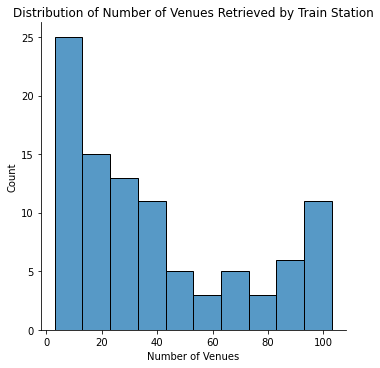

Mininum Venues Retrieved: 3
Maximum Veneus Retrieved: 100


In [33]:
bystation = venuecat_EDA.groupby('Station Name')['Venue Name'].count().reset_index()
sns.displot(x = 'Venue Name', data = bystation, binwidth = 10)
plt.xlabel('Number of Venues')
plt.title('Distribution of Number of Venues Retrieved by Train Station')
plt.show()

print('Mininum Venues Retrieved:', bystation['Venue Name'].min())
print('Maximum Veneus Retrieved:', bystation['Venue Name'].max())

Finally, let's remove S- and U-Bahn stations that returned less than 10 venues since including them in the cluster analysis may produce inaccurate labels.

In [34]:
toofew = bystation[bystation['Venue Name'] < 10]['Station Name']
berlinvenues_final = berlin_venues[~ berlin_venues['Station Name'].isin(toofew)]

print('Final number of stations:', berlinvenues_final['Station Name'].nunique())

Final number of stations: 78


<a id="3-9"></a>
### 3.9 Applying the K-Means Algorithm

To prepare the data for clustering, the venue categories must be one-hot encoded and aggregated so that each station would be represented by a single row and each venue category would become a column.

In [35]:
## One-hot encoding the venue dataframe
berlin_onehot = pd.get_dummies(berlinvenues_final[['Venue Category']], prefix = "", prefix_sep = "")
station_names = berlinvenues_final[['Station Name']]
berlin_onehotST = pd.merge(station_names, berlin_onehot, left_index = True, right_index = True)

## Aggregating the dataframe by stations and calculating the frequency of occurence for each venue category
onehotST_grouped = berlin_onehotST.groupby('Station Name').mean().reset_index()
onehotST_grouped.head()

,Station Name,ATM,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Amphitheater,Antique Shop,Aquarium,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Austrian Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bistro,Board Shop,Boarding House,Bookstore,Bosnian Restaurant,Botanical Garden,Boutique,Bowling Alley,Bowling Green,Brasserie,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Cafeteria,Café,Camera Store,Carpet Store,Castle,Caucasian Restaurant,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,Comedy Club,Comfort Food Restaurant,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Creperie,Cultural Center,Cupcake Shop,Currywurst Joint,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dive Bar,Dog Run,Doner Restaurant,Donut Shop,Drugstore,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Event Space,Fabric Shop,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio,Fishing Store,Flea Market,Flower Shop,Food & Drink Shop,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Go Kart Track,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Halal Restaurant,Hardware Store,Health & Beauty Service,Historic Site,History Museum,Hobby Shop,Hockey Rink,Hookah Bar,Hostel,Hotel,Hotel Bar,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Juice Bar,Karaoke Bar,Kebab Restaurant,Kofte Place,Korean Restaurant,Laser Tag,Latin American Restaurant,Lebanese Restaurant,Liquor Store,Lounge,Market,Martial Arts School,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Modern Greek Restaurant,Motel,Movie Theater,Multiplex,Museum,Music Store,Music Venue,New American Restaurant,Newsstand,Nightclub,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Café,Pet Store,Pharmacy,Photography Studio,Piano Bar,Picnic Area,Pide Place,Pie Shop,Pizza Place,Playground,Plaza,Pool,Pool Hall,Portuguese Restaurant,Post Office,Pub,Public Art,RV Park,Ramen Restaurant,Record Shop,Rental Car Location,Rest Area,Restaurant,Rock Club,Rooftop Bar,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Schnitzel Restaurant,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Store,Shop & Service,Shopping Mall,Skate Park,Skating Rink,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,Soup Place,South Indian Restaurant,Souvlaki Shop,Spanish Restaurant,Sporting Goods Shop,Sports Bar,Sports Club,Stadium,Steakhouse,Supermarket,Sushi Restaurant,Swabian Restaurant,Syrian Restaurant,Szechuan Restaurant,Taco Place,Tanning Salon,Tapas Restaurant,Taverna,Tea Room,Tennis Court,Tennis Stadium,Thai Restaurant,Theater,Theme Restaurant,Thrift / Vintage Store,Tour Provider,Toy / Game Store,Trail,Trattoria/Osteria,Turkish Home Cooking Restaurant,Turkish Restaurant,Vacation Rental,Vegetarian / Vegan Restaurant,Video Store,Vietnamese Restaurant,Waterfall,Waterfront,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yemeni Restaurant,Yoga Studio,Zoo,Zoo Exhibit
0,S Baumschulenweg,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.043478,0.0,0.0,0.0,0.0,0.0,0.086957,0.0000

Using the <code>onehotST_grouped</code> dataframe, let's also create a new dataframe with the 5 most common venue categories for each station.

In [36]:
## Creating a function to return the 5 most common venue categories for each row
def most_common_venues(row, num_topvenues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending = False)
    return row_categories_sorted.index.values[0:num_topvenues]

## Initializing empty dataframe with station names and column names
indicators = ['st', 'nd', 'rd']
columns = ['Station Name']
for n in np.arange(5):
    try:
        columns.append('{}{} Most Common Venue'.format(n + 1, indicators[n]))
    except:
        columns.append('{}th Most Common Venue'.format(n + 1))
ST_mostcommonvenues = pd.DataFrame(columns = columns)
ST_mostcommonvenues['Station Name'] = onehotST_grouped['Station Name']

## Applying the above function
for ind in np.arange(onehotST_grouped.shape[0]):
    ST_mostcommonvenues.iloc[ind, 1:] = most_common_venues(onehotST_grouped.iloc[ind, :], 5)

ST_mostcommonvenues.head()

,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,S Baumschulenweg,Supermarket,Café,Drugstore,Bakery,Newsstand
1,S Charlottenburg,Italian Restaurant,Café,Vietnamese Restaurant,Thai Restaurant,German Restaurant
2,S Feuerbachstr.,Clothing Store,Café,Supermarket,Italian Restaurant,Coffee Shop
3,S Friedrichsfelde Ost,Supermarket,Italian Restaurant,Asian Restaurant,Cafeteria,Bank
4,S Heerstr.,Plaza,Italian Restaurant,Supermarket,Café,Hotel


Now, let's apply K-Means clustering using 3 clusters and add the labels to a dataframe with each station's name, locality, borough, latitude, and longitude, as well as the five most common venues data from the <code>ST_mostcommonvenues</code> dataframe.

In [37]:
onehotST_grouped_clust = onehotST_grouped.drop('Station Name', axis = 1) # Keeping only numeric values for clustering
kmeans = KMeans(n_clusters = 3,max_iter = 1000, random_state = 42).fit(onehotST_grouped_clust) # Fitting KMeans to data
ST_mostcommonvenues.insert(0, 'Cluster Labels', kmeans.labels_) # Adding labels

clusteredstations = stations_clust # Retrieving geographical information
clusteredstations = clusteredstations.join(ST_mostcommonvenues.set_index('Station Name'), on = 'Station Name') # Retrieving venue information

clusteredstations.dropna(axis = 0, inplace = True) # Dropping stations that were removed in Step 3.8 due to too few venues
clusteredstations.drop('Coordinates', axis = 1, inplace = True)
clusteredstations['Cluster Labels'] = clusteredstations['Cluster Labels'].astype(int)

In [38]:
clusteredstations.head(10)

,Station Name,Locality,Borough,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,52.503751,13.331400,0,Hotel,Zoo Exhibit,Café,Clothing Store,Cocktail Bar
1,U Hermannplatz,Neukölln,Neukölln,52.486662,13.425104,1,Bar,Coffee Shop,Café,Pizza Place,Italian Restaurant
2,S+U Neukölln,Neukölln,Neukölln,52.469287,13.442349,1,Bar,Café,Plaza,Ice Cream Shop,Middle Eastern Restaurant
3,U Leopoldplatz,Wedding,Mitte,52.546481,13.359376,1,Café,Bar,Drugstore,Bakery,Grocery Store
4,U Osloer Straße,Gesundbrunnen,Mitte,52.556926,13.373265,1,Bar,Café,Bakery,Soccer Field,Doner Restaurant
5,U Nauener Platz,Wedding,Mitte,52.551512,13.367346,1,Bar,Café,Ice Cream Shop,Bakery,Restaurant
6,U Amrumer Straße,Wedding,Mitte,52.542191,13.349515,1,Café,Bar,Gas Station,Korean Restaurant,Italian Restaurant
7,U Schloßstraße,Steglitz,Steglitz-Zehlendorf,52.461172,13.324817,0,Café,Sushi Restaurant,Korean Restaurant,Supermarket,Clothing Store
8,U Walther-Schreiber-Platz,Steglitz,Tempelhof-Schöneberg,52.464866,13.328754,0,Supermarket,Sushi Restaurant,Vietnamese Restaurant,Café,Ice Cream Shop
11,U Blaschkoallee,Britz,Neukölln,52.452399,13.449005,2,Supermarket,Gas Station,Playground,Park,Soccer Field


<a id="3-10"></a>
### 3.10 Mapping and Characterizing Clusters

In [39]:
clusters = folium.Map(location=[52.520008, 13.404954], tiles="cartodbpositron", zoom_start=10) # Creating basemap using coordinates for Berlin

## Adding in all localities as background
folium.features.GeoJson(data = gdf_oteil,name='Labels',style_function=lambda x: {'color':'grey','fillColor':'grey',
                                                                                 'weight':0.7,'opacity':0.4}).add_to(clusters)

## Adding in localities in the clusteredstations dataframe as foreground with emphasis and labels
folium.features.GeoJson(data = gdf_oteil[gdf_oteil['OTEIL'].isin(clusteredstations['Locality'])],name='Labels',
                        style_function=lambda x: {'color':'black','fillColor':'black','weight':1,'opacity':0.5},
                        tooltip=folium.features.GeoJsonTooltip(fields=['OTEIL'], aliases = ['Locality'],labels=True, sticky=True)).add_to(clusters)

labeled_stops = folium.map.FeatureGroup() # Initiating a new feature group


## Looping through clusteredstations dataframe and adding a marker to the feature group for each station
markers_colors = {'0':'#14e8ff','1':'#3b838c','2':'#6af7c6'}
for lat,long,name,cluster in zip(clusteredstations['Latitude'],clusteredstations['Longitude'],
                                 clusteredstations['Station Name'],clusteredstations['Cluster Labels']):
    label = folium.Popup(str(name) + ' : Cluster ' + str(cluster), parse_html=True)
    labeled_stops.add_child(folium.features.CircleMarker([lat, long],radius = 3, color = 'black', fill = True,
                                                         fill_color = markers_colors[str(cluster)], weight = 0.5, popup = label,
                                                        fill_opacity = 1))

clusters.add_child(labeled_stops)

clusters

Finally, to facilitate the process of describing each cluster type, let's create a dataframe with each station's name, locality, borough, and cluster label plus each venue's name, main category, and subcategory.

In [40]:
## Dropping stations with too few surrounding venues
dropped_venuecat_EDA = venuecat_EDA[~venuecat_EDA['Station Name'].isin(toofew)] 

## Merging with clustered stations to retrieve missing columns and then keeping only needed ones
merged_venuecat_EDA = dropped_venuecat_EDA.merge(clusteredstations, left_on = 'Station Name', right_on = 'Station Name')
describeclusters = merged_venuecat_EDA[['Station Name','Locality','Borough','Cluster Labels','Venue Name','Main Category','Subcategory']]

describeclusters.head(5)

,Station Name,Locality,Borough,Cluster Labels,Venue Name,Main Category,Subcategory
0,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,0,Hotel Zoo,Travel & Transport,Hotel
1,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,0,Motel One Upper West,Travel & Transport,Hotel
2,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,0,Waldorf Astoria Berlin,Travel & Transport,Hotel
3,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,0,Dorint Kurfürstendamm Berlin,Travel & Transport,Hotel
4,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,0,Swissôtel Berlin,Travel & Transport,Hotel


##  4. Results

The three criteria used to narrow down the 96 localities to the 20 most suitable areas for university students were:

1) Proximity to universities measured by the number of universities reachable within an 8.36 km radius of the locality 
2) Rent prices in 2019 measured in euros per meters squared
3) Proportion of young adults living in the locality in 2019 out of the locality's total population

These 20 localities can be seen in the sorted table below. The locality with the highest proximity score is Gesundbrunnen with a count of 27 universities, while the lowest is Niederschöneweide with a count of 8. The lowest rent prices of 8.3 euros per meters squared can be found in Haselhorst, while the locality with the highest rent prices is Charlottenburg at 11.1 euros per meters squared. The locality with the youngest demographics is Wedding with a young adult proportion of 24.66%, while the locality with lowest proportion of young adults is Baumschulenweg at 15.58%.

In [41]:
## Merging to obtain information on distance to universities, rent prices, and proportion of young adults for the final 20 localities
describelocalities = rentxyoungxdist.merge(distancetouni_final, left_on = 'Locality Name', right_on = 'Locality',how = 'inner')[['Locality Name', 'Count']]
describelocalities = describelocalities.merge(youngadults_final, on = 'Locality Name', how = 'inner')[['Locality Name','Count','Young Adult Proportion(%)']]
describelocalities = describelocalities.merge(rentprices_final, on = 'Locality Name', how = 'inner')[['Locality Name', 'Count','Rent Prices 2019(€)','Young Adult Proportion(%)']]

## Sorting values by highest count(able to reach the highest number of unis), lowest rent prices, then highest young adult proportion
describelocalities = describelocalities.sort_values(by = ['Count','Rent Prices 2019(€)','Young Adult Proportion(%)'],
                                                    ascending = (False, True, False)).reset_index(drop = True)
describelocalities

,Locality Name,Count,Rent Prices 2019(€),Young Adult Proportion(%)
0,Gesundbrunnen,27,10.0,24.07
1,Charlottenburg,27,11.1,18.02
2,Tempelhof,26,10.2,18.27
3,Wedding,25,11.0,24.66
4,Charlottenburg-Nord,24,8.8,16.91
5,Reinickendorf,24,9.5,19.73
6,Neukölln,23,8.9,20.23
7,Steglitz,23,10.7,16.59
8,Fennpfuhl,17,9.5,17.88
9,Britz,16,9.3,17.51


In [42]:
describelocalities[~describelocalities['Locality Name'].isin(describeclusters['Locality'])]

,Locality Name,Count,Rent Prices 2019(€),Young Adult Proportion(%)
4,Charlottenburg-Nord,24,8.8,16.91
11,Borsigwalde,14,9.2,17.91


Within these 20 localities, there were a total of 97 S- and U-Bahn stations, which were the origin points when searching for venue data using the Foursquare API. In other words, there were 97 potential neighborhoods.

Out of these 97 potential neighborhoods, 18 were dropped from the cluster analysis because they had less than 10 venues within a 700 meters walking catchment, leaving a total of 79 stations. Due to this change, only 19 localities were represented in the final list of train stations used for clustering. The locality that was dropped from the cluster analysis was Borsigwalde.

The table below lists the number of stations by locality and cluster type. Charlottenburg has the highest number of stations with all 17 stations belonging to Cluster 1. Within a locality, it is more common for the stations to share the same cluster type as opposed to having a variety. The clearest exception would be Tempelhof, Neukölln, and Wedding, which possess all three cluster types.

In [43]:
ST_byloc_byclust = pd.DataFrame(clusteredstations.groupby(['Locality','Cluster Labels']).count()[['Station Name']])
ST_byloc_byclust.rename(columns = {'Station Name':'Number of Stations'}, inplace = True)
ST_byloc_byclust

Number of Stations
Locality          Cluster Labels                    
Baumschulenweg    2                                1
Britz             0                                1
                  2                                1
Charlottenburg    0                               17
Fennpfuhl         2                                1
Friedrichsfelde   2                                3
Gesundbrunnen     0                                2
                  1                                4
Haselhorst        0                                1
Lichtenberg       2                                1
Mariendorf        2                                2
Neukölln          0                                1
                  1                                8
                  2                                1
Niederschöneweide 2                                1
Reinickendorf     0                                1
                  2                                2
Siemensstadt      0                                2
                  2                                1
Steglitz          0                                4
Tempelhof         0                                3
                  2                                3
Wedding           0                                1
                  1                                7
Westend           0                                7
Wittenau          0                                1
                  2                                1

Now let's examine each cluster type and describe their characteristics using the 5 most common venue subcategories and the frequency of each main category.

### Cluster 0

In [44]:
clustzero = clusteredstations[clusteredstations['Cluster Labels'] == 0].reset_index(drop = True)

print('1st Most Common Venue of Cluster Zero :', clustzero['1st Most Common Venue'].value_counts().idxmax())
print('2nd Most Common Venue of Cluster Zero :', clustzero['2nd Most Common Venue'].value_counts().idxmax())
print('3rd Most Common Venue of Cluster Zero :', clustzero['3rd Most Common Venue'].value_counts()[1:2].index.item()) # Not counting cafes twice
clustzero

1st Most Common Venue of Cluster Zero : Hotel
2nd Most Common Venue of Cluster Zero : Italian Restaurant
3rd Most Common Venue of Cluster Zero : Italian Restaurant


,Station Name,Locality,Borough,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,U Kurfürstendamm,Charlottenburg,Charlottenburg-Wilmersdorf,52.503751,13.331400,0,Hotel,Zoo Exhibit,Café,Clothing Store,Cocktail Bar
1,U Schloßstraße,Steglitz,Steglitz-Zehlendorf,52.461172,13.324817,0,Café,Sushi Restaurant,Korean Restaurant,Supermarket,Clothing Store
2,U Walther-Schreiber-Platz,Steglitz,Tempelhof-Schöneberg,52.464866,13.328754,0,Supermarket,Sushi Restaurant,Vietnamese Restaurant,Café,Ice Cream Shop
3,U Grenzallee,Britz,Neukölln,52.463505,13.444808,0,Bakery,Hotel,Rental Car Location,Supermarket,Hookah Bar
4,U Zitadelle,Haselhorst,Spandau,52.537511,13.217607,0,Gym / Fitness Center,Go Kart Track,Beer Store,Sports Bar,Big Box Store
5,U Siemensdamm,Siemensstadt,Spandau,52.537014,13.273305,0,Italian Restaurant,Supermarket,German Restaurant,Restaurant,BBQ Joint
6,U Adenauerplatz,Charlottenburg,Charlottenburg-Wilmersdorf,52.500074,13.307329,0,Hotel,Italian Restaurant,Plaza,Bakery,Sushi Restaurant
7,U Rohrdamm,Siemensstadt,Spandau,52.536932,13.264164,0,Italian Restaurant,Supermarket,Hotel,Historic Site,Ice Cream Shop
8,U Mierendorffplatz,Charlottenburg,Charlottenburg-Wilmersdorf,52.525966,13.305697,0,Supermarket,Hotel,Café,Italian Restaurant,Asian Restaurant
9,U Richard-Wagner-Platz,Charlottenburg,Charlottenburg-Wilmersdorf,52.517142,13.307203,0,Supermarket,Italian Restaurant,Café,Hotel,Pizza Place


In [45]:
clustzero_2 = describeclusters[describeclusters['Cluster Labels'] == 0]
print('Average number of venues per station:', round(clustzero_2.groupby('Station Name').count()['Venue Name'].mean()))

clustzero_2 = clustzero_2.groupby('Main Category').count()[['Subcategory']]
clustzero_2.columns = ['Count']
clustzero_2['Percentage'] = round((clustzero_2['Count']/clustzero_2['Count'].sum()) * 100, 1)
clustzero_2.sort_values(by = 'Percentage', ascending = False)

Average number of venues per station: 51


,Count,Percentage
Main Category,,
Food,1159,55.1
Shop & Service,413,19.6
Outdoors & Recreation,158,7.5
Arts & Entertainment,133,6.3
Travel & Transport,120,5.7
Nightlife Spot,108,5.1
Professional & Other Places,10,0.5
College & University,3,0.1


There are 20 stations in Cluster Zero. 8 stations are in Neukölln, 6 in Wedding, 5 in Gesundbrunnen, and 1 in Tempelhof. On average, there are 63 venues within 700 meters of each station. Most of the venues in Cluster Zero are categorized as food (53.6%), followed by nightlife spot (17.6%) and shop & service (12.8%). The 1st most common venue subcategory in Cluster Zero is cafes, the 2nd most common is bars, and the 3rd most common is pubs.

### Cluster 1

In [46]:
clustone = clusteredstations[clusteredstations['Cluster Labels'] == 1].reset_index(drop = True)

print('1st Most Common Venue of Cluster One :', clustone['1st Most Common Venue'].value_counts().idxmax())
print('2nd Most Common Venue of Cluster One :', clustone['2nd Most Common Venue'].value_counts().idxmax())
print('3rd Most Common Venue of Cluster One :', clustone['3rd Most Common Venue'].value_counts()[2:3].index.item()) # Not counting supermarkets or Italian twice
clustone

1st Most Common Venue of Cluster One : Bar
2nd Most Common Venue of Cluster One : Bar
3rd Most Common Venue of Cluster One : Italian Restaurant


,Station Name,Locality,Borough,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,U Hermannplatz,Neukölln,Neukölln,52.486662,13.425104,1,Bar,Coffee Shop,Café,Pizza Place,Italian Restaurant
1,S+U Neukölln,Neukölln,Neukölln,52.469287,13.442349,1,Bar,Café,Plaza,Ice Cream Shop,Middle Eastern Restaurant
2,U Leopoldplatz,Wedding,Mitte,52.546481,13.359376,1,Café,Bar,Drugstore,Bakery,Grocery Store
3,U Osloer Straße,Gesundbrunnen,Mitte,52.556926,13.373265,1,Bar,Café,Bakery,Soccer Field,Doner Restaurant
4,U Nauener Platz,Wedding,Mitte,52.551512,13.367346,1,Bar,Café,Ice Cream Shop,Bakery,Restaurant
5,U Amrumer Straße,Wedding,Mitte,52.542191,13.349515,1,Café,Bar,Gas Station,Korean Restaurant,Italian Restaurant
6,U Karl-Marx-Straße,Neukölln,Neukölln,52.476418,13.439785,1,Café,Bar,Art Gallery,Coffee Shop,Plaza
7,U Rathaus Neukölln,Neukölln,Neukölln,52.481057,13.435227,1,Bar,Coffee Shop,Café,Italian Restaurant,Cocktail Bar
8,U Pankstraße,Gesundbrunnen,Mitte,52.552243,13.381818,1,Bar,Turkish Restaurant,Clothing Store,Café,Hotel
9,U Voltastraße,Gesundbrunnen,Mitte,52.541137,13.393850,1,Café,Ice Cream Shop,Bakery,Coffee Shop,Flea Market


In [47]:
clustone_2 = describeclusters[describeclusters['Cluster Labels'] == 1]
print('Average number of venues per station:', round(clustone_2.groupby('Station Name').count()['Venue Name'].mean()))

clustone_2 = clustone_2.groupby('Main Category').count()[['Subcategory']]
clustone_2.columns = ['Count']
clustone_2['Percentage'] = round((clustone_2['Count']/clustone_2['Count'].sum()) * 100, 1)
clustone_2.sort_values(by = 'Percentage', ascending = False)

Average number of venues per station: 61


,Count,Percentage
Main Category,,
Food,625,53.8
Nightlife Spot,208,17.9
Shop & Service,149,12.8
Outdoors & Recreation,83,7.1
Arts & Entertainment,70,6.0
Travel & Transport,21,1.8
Professional & Other Places,5,0.4


Cluster One has 43 stations, the highest of all the clusters. This cluster is extremely spaced out compared to Cluster Zero. 17 stations are in Charlottenburg, 7 in Westend, 4 in Tempelhof, 4 in Steglitz, 2 in Reinickendorf, 2 in Siemensstadt, and 1 each in Lichtenbrg, Haselhorst, Neukölln, Gesundbrunnen, Baumschulenweg, Wedding, and Britz. On average, there are 49 venues within 700 meters of each station. Most of the venues in Cluster One are categorized as food (55.1%), followed by shop & service (20.6%) and outdoors & recreation (7.1%). The 1st most common venue subcategory is supermarkets, the 2nd most common is Italian restaurants, and the 3rd most common is cafes.

### Cluster 2

In [48]:
clusttwo = clusteredstations[clusteredstations['Cluster Labels'] == 2].reset_index(drop = True)

print('1st Most Common Venue of Cluster Two :', clusttwo['1st Most Common Venue'].value_counts().idxmax())
print('2nd Most Common Venue of Cluster Two :', clusttwo['2nd Most Common Venue'].value_counts().idxmax())
print('3rd Most Common Venue of Cluster Two :', clusttwo['3rd Most Common Venue'].value_counts().idxmax())
clusttwo

1st Most Common Venue of Cluster Two : Supermarket
2nd Most Common Venue of Cluster Two : Italian Restaurant
3rd Most Common Venue of Cluster Two : Drugstore


,Station Name,Locality,Borough,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,U Blaschkoallee,Britz,Neukölln,52.452399,13.449005,2,Supermarket,Gas Station,Playground,Park,Soccer Field
1,U Paulsternstraße,Siemensstadt,Spandau,52.538087,13.248574,2,Supermarket,Furniture / Home Store,Playground,Sandwich Place,Fast Food Restaurant
2,U Friedrichsfelde,Friedrichsfelde,Lichtenberg,52.505884,13.512771,2,Supermarket,Bakery,Drugstore,Hotel,Stadium
3,U Magdalenenstraße,Lichtenberg,Lichtenberg,52.512202,13.489419,2,Bakery,Supermarket,Hotel,Italian Restaurant,Asian Restaurant
4,U Tierpark,Friedrichsfelde,Lichtenberg,52.497225,13.523606,2,Supermarket,Drugstore,Hotel,Snack Place,Playground
5,U Rathaus Reinickendorf,Wittenau,Reinickendorf,52.588206,13.325549,2,Supermarket,Park,Trattoria/Osteria,Electronics Store,Church
6,U Residenzstraße,Reinickendorf,Reinickendorf,52.570550,13.360859,2,Supermarket,Bank,Bakery,Market,Park
7,U Franz-Neumann-Platz,Reinickendorf,Reinickendorf,52.563678,13.364480,2,Supermarket,Market,Grocery Store,Shopping Mall,Pet Store
8,U Alt-Tempelhof,Tempelhof,Tempelhof-Schöneberg,52.465919,13.385777,2,Supermarket,Park,Italian Restaurant,Café,Fried Chicken Joint
9,U Kaiserin-Augusta-Straße,Tempelhof,Tempelhof-Schöneberg,52.460501,13.384886,2,Supermarket,Café,Park,Doner Restaurant,Drugstore


In [49]:
clusttwo_2 = describeclusters[describeclusters['Cluster Labels'] == 2]
print('Average number of venues per station:', round(clusttwo_2.groupby('Station Name').count()['Venue Name'].mean()))

clusttwo_2 = clusttwo_2.groupby('Main Category').count()[['Subcategory']]
clusttwo_2.columns = ['Count']
clusttwo_2['Percentage'] = round((clusttwo_2['Count']/clusttwo_2['Count'].sum()) * 100, 1)
clusttwo_2.sort_values(by = 'Percentage', ascending = False)

Average number of venues per station: 21


,Count,Percentage
Main Category,,
Shop & Service,163,42.3
Food,148,38.4
Outdoors & Recreation,41,10.6
Arts & Entertainment,14,3.6
Nightlife Spot,8,2.1
Travel & Transport,6,1.6
Professional & Other Places,5,1.3


There are 16 stations in Cluster Two. Like Cluster One, this cluster is also spatially distributed. 2 stations are in Wittenau, 2 in Friedrichsfelde, 2 in Mariendrof, and 1 each in Fennpfuhl, Tempelhof, Charlottenburg-Nord, Reinickendorf, Niederschöneweide, Steglitz, Siemensstadt, Neukölln, Wedding, and Britz. On average, there are 17 venues within 700 meters of each station. Most of the venues in Cluster Two are categorized as shop & service (39.6%), followed by food (35.2%) and outdoors & recreation (13.9%). The 1st most common venue subcategory is supermarkets, the 2nd most common is parks, and the 3rd most common is drugstores.

## 5. Discussion

Based on the characteristics of the three clusters, the following recommendations can be made to prospective university students:

* Stations in Cluster Zero serve as suitable neighborhoods for university students who thrive in a lively environment and would like to participate in the area's bustling social scenes. These neighborhoods are good for students who love to go out but prefer cheaper rent prices compared to areas with Berlin's top nightlife spots such as Prenzlauer Berg, Mitte, Kreuzberg, and Friedrichshain.
* In comparison to Cluster Zero, stations in Cluster One and Two are better options for university students who do not put as much priority on the nightlife scene. Both clusters offer similar venue categories such as supermarkets and restaurants. These neighborhoods are geared towards students who seek comfort and convenience. 
* However, stations in Cluster Two would be more suitable than those in Cluster One for students who prefer to live in a quieter neighborhood and value their privacy.

### 5.1 Future Recommendations

While this project used only three criteria for selecting localities, there are several other factors that are just as important to university students looking for a new home. These include, but are not limited to, crime rates and personal safety, job opportunities, the price range and ratings of surrounding venues, and the socioeconomic characteristics of their neighbors. However, an important caveat to mention is the findings produced using data science may not correspond with student's perceptions and interests. There is most likely a correlation between high rent prices and high livability. Some students may be willing to pay more to live only a few blocks away from social venues and their friends or to live in a hip neighborhood.

Furthermore, housing was examined in this project only from the perspective of rent prices, but in Berlin, shared apartments (Wohngemeinschaft) and student accommodations (Studentenwohnheim) are pretty popular, which could allow for cheaper rent prices in areas that are typically more expensive. Another factor that future studies could take into consideration is incorporating bus stops and tram stations into the dataset, which could result in more unique cluster types and more accurately capture the experience of living in the outer localities.

Besides including more variables into the analysis, future studies could also optimize the number of clusters used for the K-means algorithm by applying the elbow method or the silhouette score. Finally, another potential data product to examine is a classification model that takes user inputs such as a specific university or venue category and assigns a cluster label, allowing the user to effectively narrow down their apartment search.

## 6. Conclusion

This project's main goals were to identify the most appealing neighborhoods in Berlin to university students and to describe the experiences of living in one of these neighborhoods using venue data. The end results of this project fulfilled these goals by creating the list of 20 localities and segmenting the train stations into three clusters with unique venue categories and characteristics. Stakeholders could apply a similar methodology to find the best neighborhoods for themselves or their clients, and this workflow could easily be generalized to other location problems such as finding the best site to open an organic produce store.

This project was a great opportunity for to me to demonstrate the data science skills that I've acquired from the IBM course and from my self-study and integrate them into a comprehensive project. I felt challenged when I pushed the limits of my skillset but satisfied as I started developing my independence as a data scientist. There's a lot more to learn, and I am excited for my journey ahead.